In [3]:
from matplotlib import pyplot as plt
import numpy as np
from skimage.data import shepp_logan_phantom
from skimage.transform import rescale, resize, downscale_local_mean
import math
import os
import numpy as np

import sigpy as sp
import sigpy.plot as pl
import seaborn as sns
from cmcrameri import cm

from dipy.segment.mask import median_otsu
from dipy.io.image import load_nifti, save_nifti
from dipy.io.gradients import read_bvals_bvecs
import numpy as np
import nrrd
import pingouin as pg
import scikit_posthocs as sp

import seaborn as sns
sns.set(style='darkgrid', palette='Set2')

import sys
sys.path.append("/Users/arielhannum/Documents/Stanford/CMR-Setsompop/Code/cDTI_python")
from mystic_mrpy.Data_Import.Diffusion   import *
from mystic_mrpy.Data_Sorting.Diffusion  import *
from mystic_mrpy.Diffusion.DWI  import *
from mystic_mrpy.Diffusion.Gibbs         import *
from mystic_mrpy.Diffusion.Registration  import *
from mystic_mrpy.Diffusion.Rejection     import *
from mystic_mrpy.Diffusion.Respiratory   import *
from mystic_mrpy.Diffusion.Averaging     import *
from mystic_mrpy.Diffusion.Denoising     import *
from mystic_mrpy.Diffusion.Interpolation import *
from mystic_mrpy.Diffusion.Segmentation_Matrix_DTI import *
from mystic_mrpy.Diffusion.DTI import *
from mystic_mrpy.Diffusion.cDTI import *

import numpy as np
import matplotlib.pyplot as plt

/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/dicom/__init__.py:53: UserWarning: 
This code is using an older version of pydicom, which is no longer 
maintained as of Jan 2017.  You can access the new pydicom features and API 
by installing `pydicom` from PyPI.
See 'Transitioning to pydicom 1.x' section at pydicom.readthedocs.org 
for more information.

  warnings.warn(msg)


In [4]:
volunteers=[1,2,3,4,5,7,8,9,10,11]

M0_std = np.zeros((128,128,6,4,8,10)) #[lb ub, #volunteers, #slices,TD]
M1_std = np.zeros((128,128,6,4,8,10)) #[lb ub, #volunteers, #slices,TD]
M2_std = np.zeros((128,128,6,4,8,10)) #[lb ub, #volunteers, #slices,TD]


M0_diff = np.zeros((128,128,6,4,5,8,10),dtype='complex') #[lb ub, #volunteers, #slices,TD]
M1_diff = np.zeros((128,128,6,4,5,8,10),dtype='complex') #[lb ub, #volunteers, #slices,TD]
M2_diff = np.zeros((128,128,6,4,5,8,10),dtype='complex') #[lb ub, #volunteers, #slices,TD]

M0_mask = np.zeros((128,128,6,4,5,8,10)) #[lb ub, #volunteers, #slices,TD]
M1_mask = np.zeros((128,128,6,4,5,8,10)) #[lb ub, #volunteers, #slices,TD]
M2_mask = np.zeros((128,128,6,4,5,8,10)) #[lb ub, #volunteers, #slices,TD]

for vv in range(10):
    # For each volunteer 
    M0_mag = np.zeros((128,128,6,4,5,8))
    M1_mag = np.zeros((128,128,6,4,5,8))
    M2_mag = np.zeros((128,128,6,4,5,8))

    M0_phs = np.zeros((128,128,6,4,5,8))
    M1_phs = np.zeros((128,128,6,4,5,8))
    M2_phs = np.zeros((128,128,6,4,5,8))


    volunteer = str(volunteers[vv])
    print(volunteer, end = ' ')
    inpath = '/Users/arielhannum/Documents/Stanford/CMR-Setsompop/Projects/Phase/Data/Brain/V00' + volunteer + '/3_DWI/'
    name = inpath.split('/')
    namejoin = '/'.join(name[:-1])

    num = 0
    for num in range(3):
        nii_files   = [_ for _ in os.listdir(inpath) if _.endswith('registered.nii')]
        bval_files   = [_ for _ in os.listdir(inpath) if _.endswith('registered.bvals')]
        bvec_files   = [_ for _ in os.listdir(inpath) if _.endswith('registered.bvecs')]
        mask_files   = [_ for _ in os.listdir(inpath) if _.endswith('new.nrrd')]
        

        nii_files.sort()
        bval_files.sort()
        bvec_files.sort()
        mask_files.sort()
        
        data,affine, voxsize = load_nifti(os.path.join(inpath, nii_files[num]), return_voxsize=True)
        bvals = np.loadtxt(os.path.join(inpath,bval_files[num])) 
        bvecs = np.loadtxt(os.path.join(inpath,bvec_files[num]))
        mask,header =  nrrd.read(os.path.join(inpath, mask_files[num]))
        
        mask = mask.astype('float')
        mask[mask==0] = np.nan
        
        
        data1,bvals_sort,bvecs_sort = stacked2sorted(data,bvals,bvecs.T)
        
        ims = np.stack((data1[:,:,:,:,:5],data1[:,:,:,:,5:10],data1[:,:,:,:,10:15],
                            data1[:,:,:,:,15:20],data1[:,:,:,:,20:25],data1[:,:,:,:,25:30],
                            data1[:,:,:,:,30:35],data1[:,:,:,:,35:40]),axis = -1)  
            
        
        mag = abs(ims)
        phs = np.angle(ims)
        mask_rep = np.tile(mask[:,:,:,np.newaxis,np.newaxis,np.newaxis],(1,1,1,ims.shape[3],ims.shape[4],ims.shape[5]))
        mask_rep[mask_rep ==0] = np.nan
        
        if num == 0:
            M0_mag[:,:,:,:,:,:] = mag #* mask_rep
            M0_phs[:,:,:,:,:,:,] = phs #*mask_rep
            M0_mask[:,:,:,:,:,:,vv] = mask_rep #*mask_rep
            
        if num == 1:
            M1_mag[:,:,:,:,:,:,] = mag #* mask_rep
            M1_phs[:,:,:,:,:,:] = phs #*mask_rep
            M1_mask[:,:,:,:,:,:,vv] = mask_rep #*mask_rep
            
        if num == 2:
            M2_mag[:,:,:,:,:,:] = mag #* mask_rep
            M2_phs[:,:,:,:,:,:] = phs #*mask_rep
            M2_mask[:,:,:,:,:,:,vv] = mask_rep #*mask_rep

    # NOT divide by the average 
    M0_adj = (np.exp(1j*M0_phs))/np.nanmean(np.exp(1j*M0_phs[:,:,:,0,:,:]),axis = -2)[:,:,:,np.newaxis,np.newaxis,:]
    M1_adj = (np.exp(1j*M1_phs))/np.nanmean(np.exp(1j*M1_phs[:,:,:,0,:,:]),axis = -2)[:,:,:,np.newaxis,np.newaxis,:]
    M2_adj = (np.exp(1j*M2_phs))/np.nanmean(np.exp(1j*M2_phs[:,:,:,0,:,:]),axis = -2)[:,:,:,np.newaxis,np.newaxis,:]

    M0_diff[:,:,:,:,:,:,vv] = M0_adj / np.tile(np.nanmean(M0_adj,axis = -2)[:,:,:,:,np.newaxis,:],(1,1,1,1,5,1))
    M1_diff[:,:,:,:,:,:,vv] = M1_adj / np.tile(np.nanmean(M1_adj,axis = -2)[:,:,:,:,np.newaxis,:],(1,1,1,1,5,1))
    M2_diff[:,:,:,:,:,:,vv] = M2_adj / np.tile(np.nanmean(M2_adj,axis = -2)[:,:,:,:,np.newaxis,:],(1,1,1,1,5,1))

    M0_std[:,:,:,:,:,vv] = np.sqrt(np.sum(np.angle(M0_diff[:,:,:,:,:,:,vv])**2,axis = -2)/5)
    M1_std[:,:,:,:,:,vv] = np.sqrt(np.sum(np.angle(M1_diff[:,:,:,:,:,:,vv])**2,axis = -2)/5)
    M2_std[:,:,:,:,:,vv] = np.sqrt(np.sum(np.angle(M2_diff[:,:,:,:,:,:,vv])**2,axis = -2)/5)

1 2 3 4 5 7 8 9 10 11 

In [5]:
M0_std_mean = np.nanmean(M0_std*M0_mask[:,:,:,:,0,:,:], axis = (0,1))
M1_std_mean = np.nanmean(M1_std*M1_mask[:,:,:,:,0,:,:], axis = (0,1))
M2_std_mean = np.nanmean(M2_std*M2_mask[:,:,:,:,0,:,:], axis = (0,1))

M0_std_std = np.nanstd(M0_std*M0_mask[:,:,:,:,0,:,:], axis = (0,1))
M1_std_std = np.nanstd(M1_std*M1_mask[:,:,:,:,0,:,:], axis = (0,1))
M2_std_std = np.nanstd(M2_std*M2_mask[:,:,:,:,0,:,:], axis = (0,1))


std_all = np.stack((M0_std_mean,M1_std_mean,M2_std_mean),axis = -1)
std_std_all = np.stack((M0_std_std,M1_std_std,M2_std_std),axis = -1)

std_all.shape
std_mean = np.nanmean(std_all,axis = -2)
std_std_mean = np.nanmean(std_std_all,axis = -2)

In [6]:
import pandas as pd
colors = sns.color_palette("colorblind",3)
colors = sns.color_palette("Set2",3)
fig, axes = plt.subplots(1, 3, figsize=(15,6),sharex=True,sharey = True,dpi=1000)
dd = -1
sl = 3
error = np.nanstd(std_all,axis = -2)[sl,dd,:,:]
plot_data = pd.DataFrame(std_mean[sl,dd,:,:])
lower = std_mean[sl,dd,:,:] - error
upper = std_mean[sl,dd,:,:] + error

for ii in range(3):
    #axes[ii].errorbar(np.arange(8),std_mean[sl,dd,:,ii],error[:,ii],color = colors[ii],marker='o',markeredgecolor= 'black',linestyle = 'dotted')
    sns.lineplot( data= std_mean[sl,dd,:,ii],  ax = axes[ii],linewidth =5,marker= 'o',markersize = 15,dashes= False, color = colors[ii],legend = None, )
    axes[ii].fill_between(np.arange(8),lower[:,ii],upper[:,ii],color = colors[ii],alpha = 0.3)


    axes[ii].set_xticks([0,1,2,3,4,5,6,7])
    axes[ii].set_xticklabels([0,1,2,3,4,5,6,7],size = 35)
    axes[ii].tick_params(axis='y', which='major', labelsize=35)
    axes[ii].set_yticks([0,math.pi/8,math.pi/4,3*math.pi/8,math.pi/2])
    axes[ii].set_yticklabels(['$0$','$\pi/8$','$\pi/4$','3$\pi/8$','$\pi/2$'],size = 35,rotation = 0)
    axes[ii].set_ylim([0,math.pi/2])

plt.subplots_adjust(wspace=0.05, hspace=0.03)   
plt.show()


In [7]:
import pandas as pd
colors = sns.color_palette("colorblind",3)
colors = sns.color_palette("Set2",3)
fig, axes = plt.subplots(1, 3, figsize=(18,6),sharex=True,sharey = True,dpi=1000)
dd = -1
sl = 3
error = np.nanstd(std_std_all,axis = -2)[sl,dd,:,:]
plot_data = pd.DataFrame(std_mean[sl,dd,:,:])
lower = std_std_mean[sl,dd,:,:] - error
upper = std_std_mean[sl,dd,:,:] + error

for ii in range(3):
    #axes[ii].errorbar(np.arange(8),std_mean[sl,dd,:,ii],error[:,ii],color = colors[ii],marker='o',markeredgecolor= 'black',linestyle = 'dotted')
    sns.lineplot( data= std_std_mean[sl,dd,:,ii],  ax = axes[ii],linewidth =5,marker= 'o',markersize = 15,dashes= False, color = colors[ii],legend = None, )
    axes[ii].fill_between(np.arange(8),lower[:,ii],upper[:,ii],color = colors[ii],alpha = 0.3)


    axes[ii].set_xticks([0,1,2,3,4,5,6,7])
    axes[ii].set_xticklabels([0,1,2,3,4,5,6,7],size = 25)
    axes[ii].tick_params(axis='y', which='major', labelsize=35)
    axes[ii].set_yticks([0,math.pi/8,math.pi/4,3*math.pi/8,math.pi/2])
    axes[ii].set_yticklabels(['$0$','$\pi/8$','$\pi/4$','3$\pi/8$','$\pi/2$'],size = 35,rotation = 0)
    axes[ii].set_ylim([0,math.pi/8])

plt.subplots_adjust(wspace=0.05, hspace=0.03)   
plt.show()


# Supplemental Figures

In [8]:
import pandas as pd
colors = sns.color_palette("colorblind",3)
colors = sns.color_palette("Set2",3)

dd = -1
sl = 3
slices= [4,2,1]

fig, axes = plt.subplots(3, 3, figsize=(15,20),sharex=True,sharey = True,dpi=1000)
for sl in range(3):
    for ii in range(3):
        error = np.nanstd(std_all,axis = -2)[slices[sl],dd,:,:]
        plot_data = pd.DataFrame(std_mean[slices[sl],dd,:,:])
        lower = std_mean[slices[sl],dd,:,:] - error
        upper = std_mean[slices[sl],dd,:,:] + error


        #axes[ii].errorbar(np.arange(8),std_mean[sl,dd,:,ii],error[:,ii],color = colors[ii],marker='o',markeredgecolor= 'black',linestyle = 'dotted')
        sns.lineplot( data= std_mean[slices[sl],dd,:,ii],  ax = axes[sl,ii],linewidth =5,marker= 'o',markersize = 15,dashes= False, color = colors[ii],legend = None, )
        axes[sl,ii].fill_between(np.arange(8),lower[:,ii],upper[:,ii],color = colors[ii],alpha = 0.3)


        axes[sl,ii].set_xticks([0,1,2,3,4,5,6,7])
        axes[sl,ii].set_xticklabels([0,1,2,3,4,5,6,7],size = 30)
        axes[sl,ii].tick_params(axis='y', which='major', labelsize=30)
        axes[sl,ii].set_yticks([0,math.pi/8,math.pi/4,3*math.pi/8,math.pi/2])
        axes[sl,ii].set_yticklabels(['$0$','$\pi/8$','$\pi/4$','3$\pi/8$','$\pi/2$'],size = 35,rotation = 0)
        axes[sl,ii].set_ylim([0,math.pi/2])

plt.subplots_adjust(wspace=0.05, hspace=0.1)   
plt.show()


In [14]:
import pandas as pd
colors = sns.color_palette("colorblind",3)
colors = sns.color_palette("Set2",3)

dd = 1
sl = 3

fig, axes = plt.subplots(3, 3, figsize=(15,20),sharex=True,sharey = True,dpi=1000)
for dd in range(3):
    for ii in range(3):
        error = np.nanstd(std_all,axis = -2)[sl,dd,:,:]
        plot_data = pd.DataFrame(std_mean[sl,dd,:,:])
        lower = std_mean[sl,dd,:,:] - error
        upper = std_mean[sl,dd,:,:] + error


        #axes[ii].errorbar(np.arange(8),std_mean[sl,dd,:,ii],error[:,ii],color = colors[ii],marker='o',markeredgecolor= 'black',linestyle = 'dotted')
        sns.lineplot( data= std_mean[sl,dd,:,ii],  ax = axes[dd,ii],linewidth =5,marker= 'o',markersize = 15,dashes= False, color = colors[ii],legend = None, )
        axes[dd,ii].fill_between(np.arange(8),lower[:,ii],upper[:,ii],color = colors[ii],alpha = 0.3)


        axes[dd,ii].set_xticks([0,1,2,3,4,5,6,7])
        axes[dd,ii].set_xticklabels([0,1,2,3,4,5,6,7],size = 30)
        axes[dd,ii].tick_params(axis='y', which='major', labelsize=30)
        axes[dd,ii].set_yticks([0,math.pi/8,math.pi/4,3*math.pi/8,math.pi/2])
        axes[dd,ii].set_yticklabels(['$0$','$\pi/8$','$\pi/4$','3$\pi/8$','$\pi/2$'],size = 35,rotation = 0)
        axes[dd,ii].set_ylim([0,math.pi/2])

plt.subplots_adjust(wspace=0.05, hspace=0.1)   
plt.show()


In [10]:
std_all.shape

(6, 4, 8, 10, 3)

0


/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:194: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:199: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


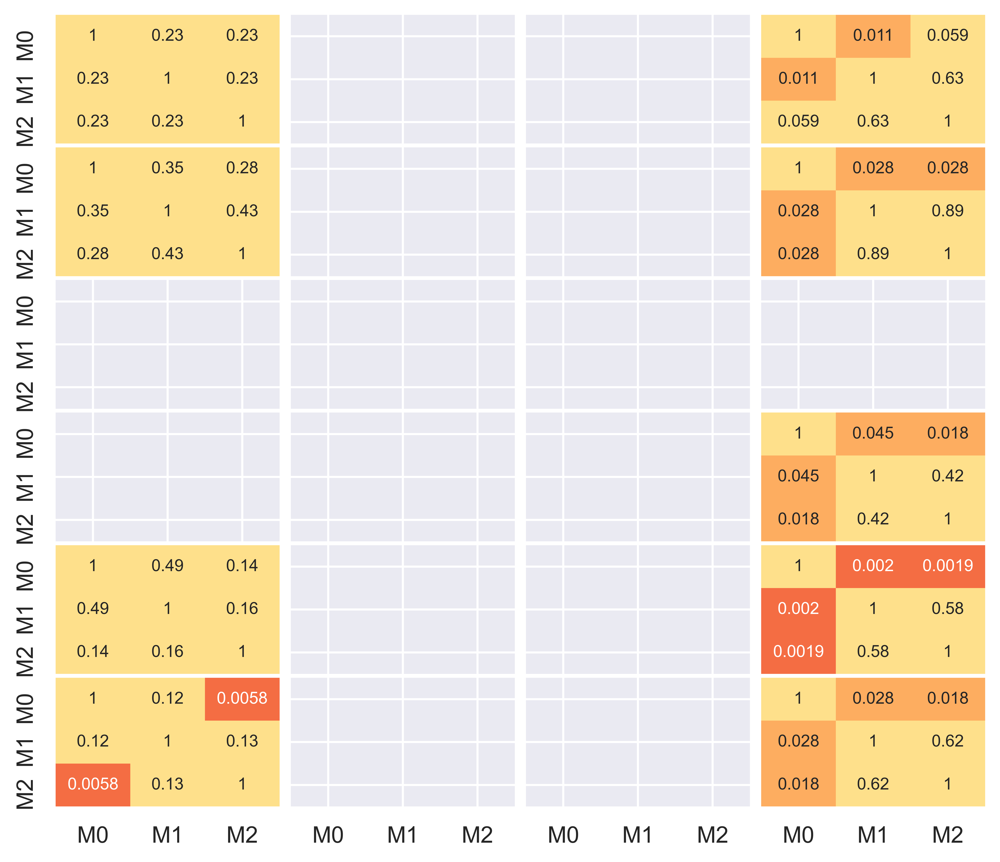

1


/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:194: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:199: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


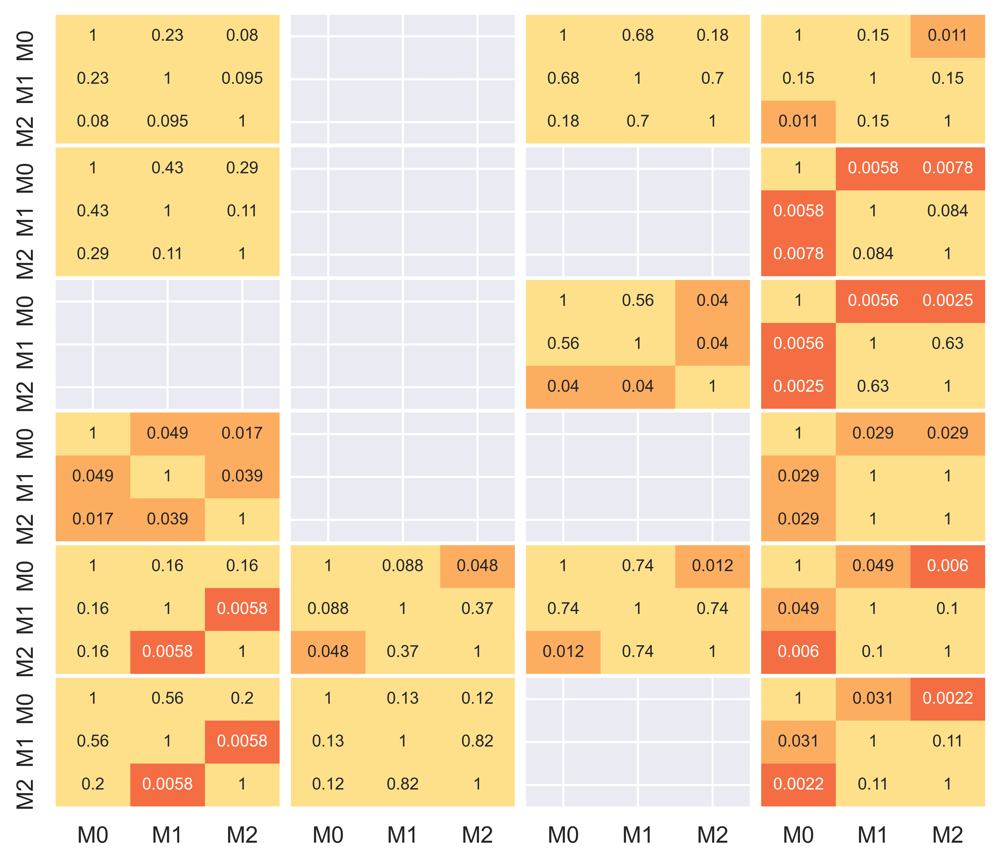

2


/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:194: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:199: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


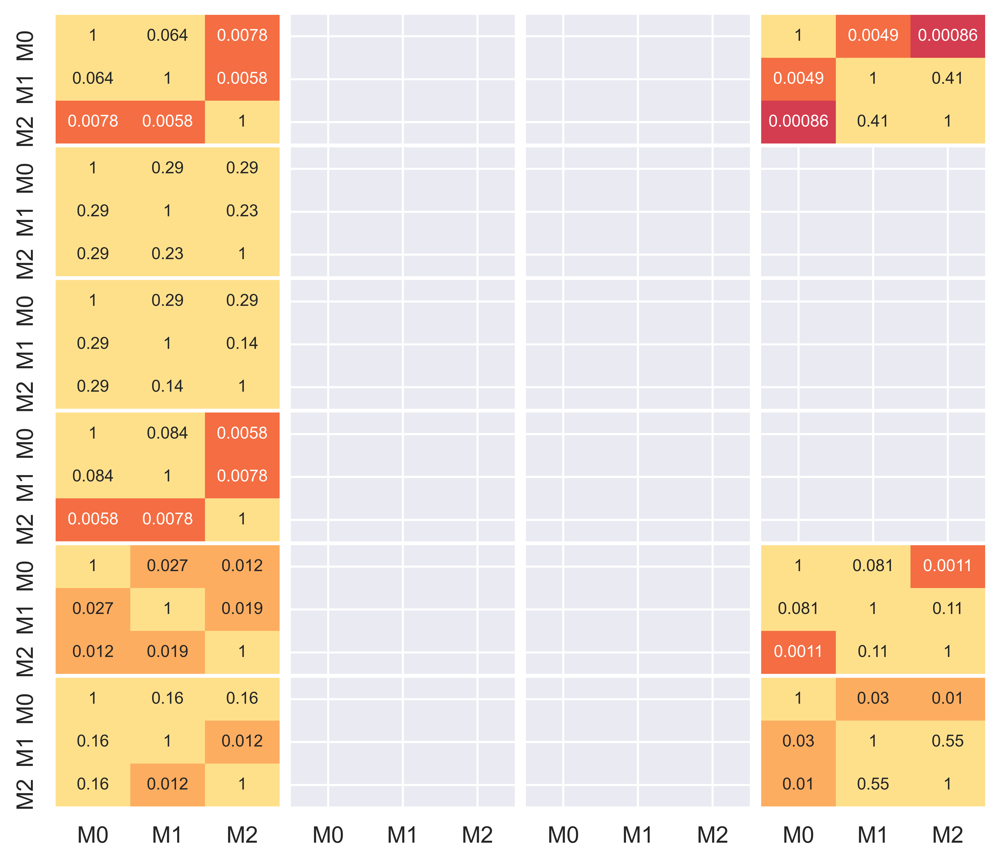

3


/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:194: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:199: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


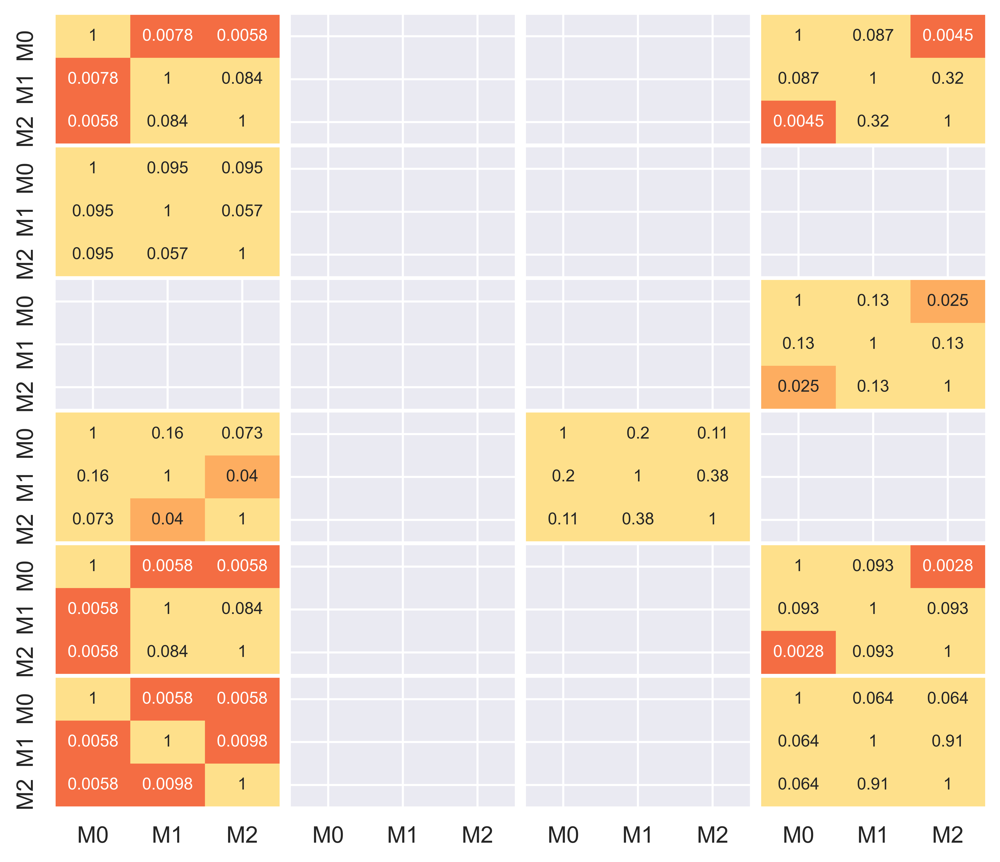

4


/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:194: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:199: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


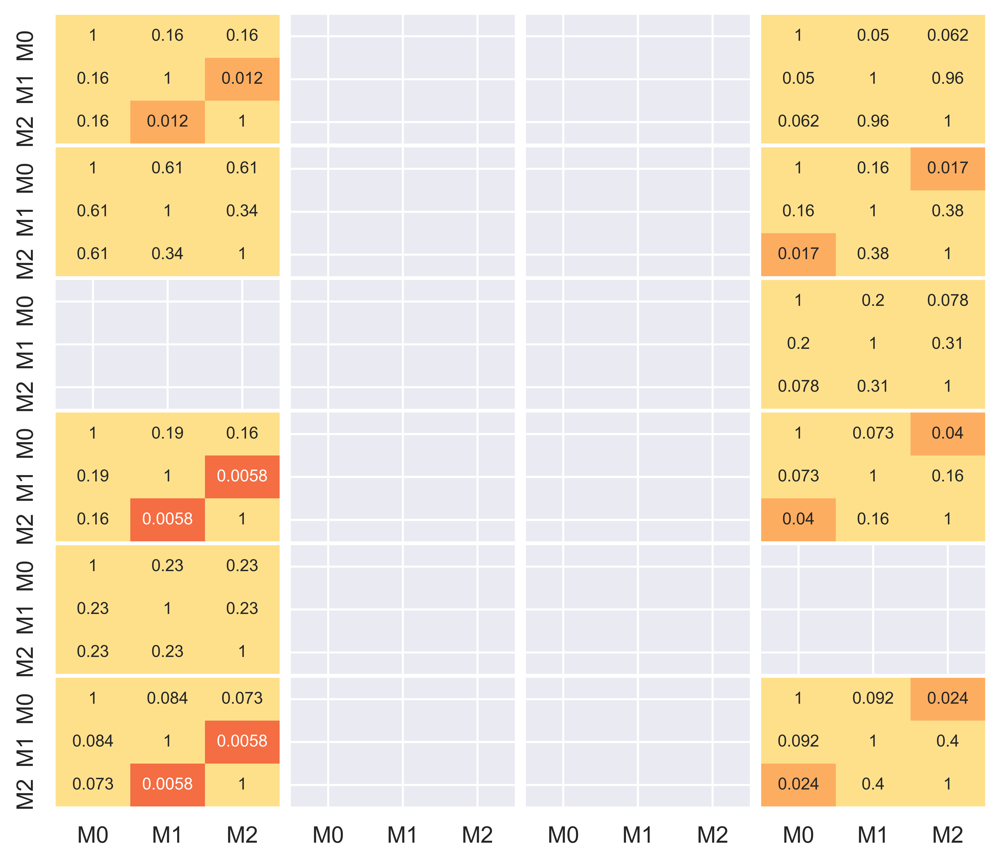

5


/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:194: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:199: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


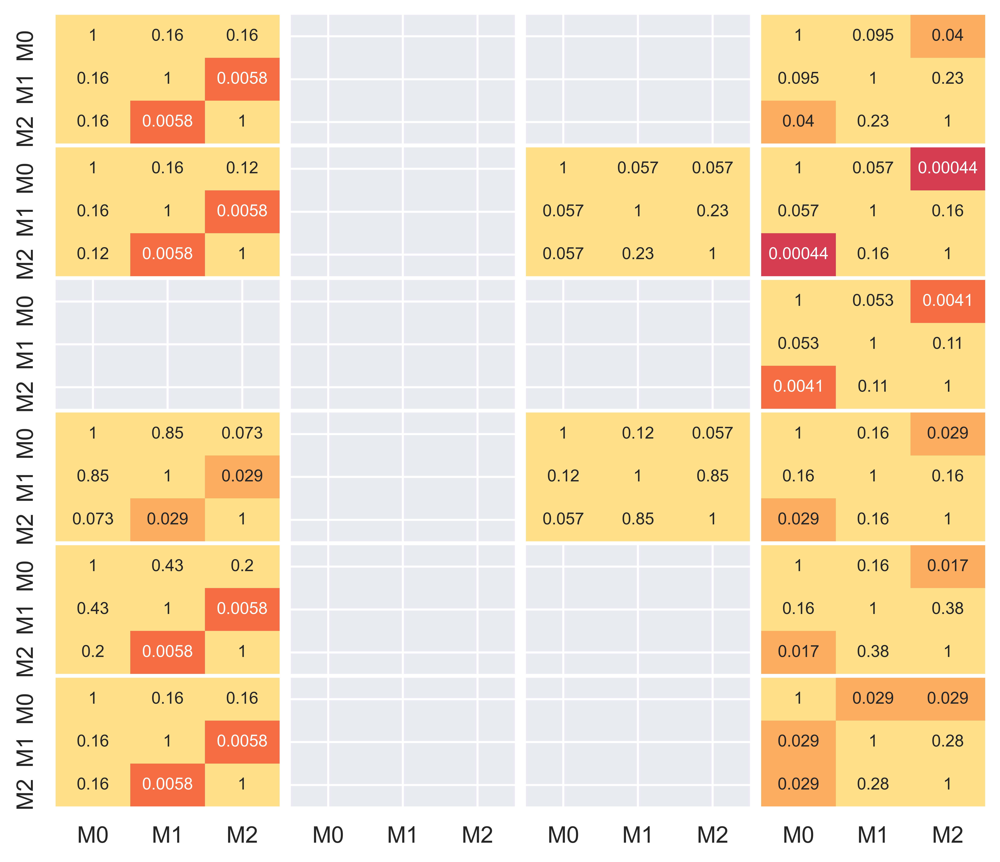

6


/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:194: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:199: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


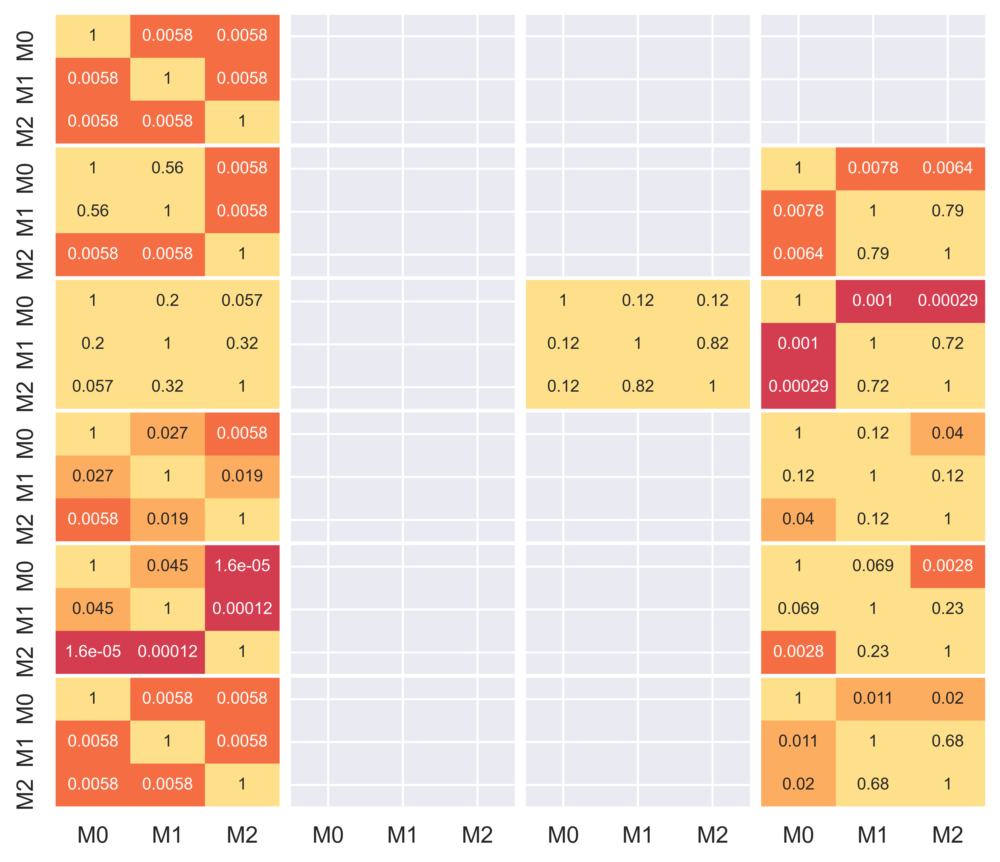

7


/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:194: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:199: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


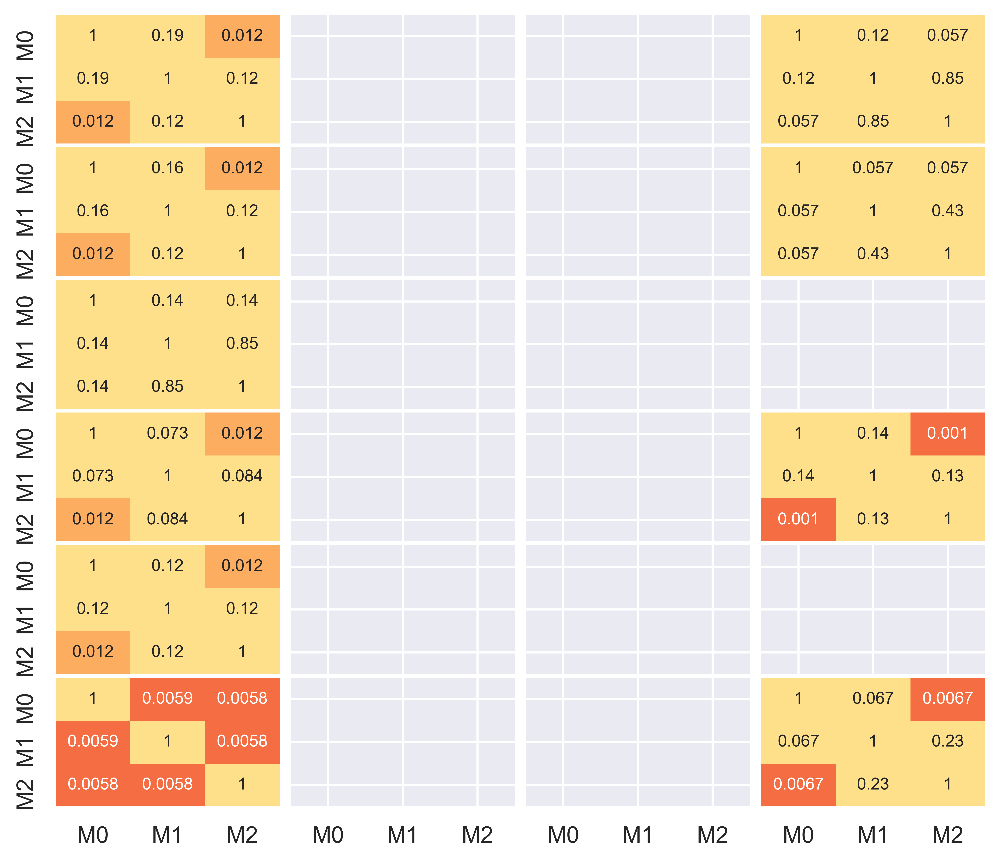

In [11]:
    
import scikit_posthocs as sp
from scipy import stats
for td in range(8):
    print(td)
    alpha= 0.05

    hypothesis = np.zeros((6,4,3,3))
    hypothesis[:] = np.nan

    slices = [5,4,3,2,1,0]
    for sl in range(6):
        for dd in range(4):
            group1 = std_all[slices[sl],dd,td,:,0]
            group2 = std_all[slices[sl],dd,td,:,1]
            group3 = std_all[slices[sl],dd,td,:,2]

            normal = 0 if stats.shapiro(group1)[1] <alpha or stats.shapiro(group2)[1] <alpha or stats.shapiro(group1)[1] <alpha else 1

            if normal ==0:
                result = stats.friedmanchisquare(group1, group2, group3)
                if result[1] < alpha:
                    test = sp.posthoc_wilcoxon([group1,group2,group3],p_adjust = 'holm-sidak')
                    hypothesis[sl,dd,:,:] = test
                else:
                    hypothesis[sl,dd,:,:] = np.nan

            elif normal ==1:
                result = stats.f_oneway(group1, group2, group3)
                if result[1] < alpha:
                    test = sp.posthoc_ttest([group1,group2,group3],p_adjust = 'holm-sidak')
                    hypothesis[sl,dd,:,:] = test 
                else:
                    hypothesis[sl,dd,:,:] = np.nan



    from matplotlib.colors import BoundaryNorm, ListedColormap
    import seaborn as sns
    import numpy as np

    my_colors = [sns.color_palette("Spectral",9)[0], sns.color_palette("Spectral",9)[1], sns.color_palette("Spectral",9)[2], 
                sns.color_palette("Spectral",9)[3]]
    my_cmap = ListedColormap(my_colors)
    bounds = [0, 0.001, 0.01, 0.05,1]
    my_norm = BoundaryNorm(bounds, ncolors=len(my_colors))

    fig, axes = plt.subplots(6, 4, figsize=(8,7),sharex=True,sharey = True,dpi=1000)
    count = 2
    for sl in range(6):
        for dirs in range(4):
            ax=sns.heatmap(hypothesis[count,dirs,:,:],ax = axes[sl,dirs], annot = True, xticklabels=['M0','M1','M2'],
                        yticklabels=['M0','M1','M2'],norm=my_norm,cmap = my_cmap,cbar = False,annot_kws={"fontsize":8})
            #c_bar = ax.collections[0].colorbar
            #c_bar.set_ticks([(0 + 0.001)/2,(0.001+0.01)/2,(0.01+0.05)/2,(0.05+1)/2])
            #c_bar.set_ticklabels(['p<0.001','p<0.01','p<0.05','n.s.'])  
            #c_bar.set_ticklabels(['p<0.001','p<0.01','p<0.05','n.s.'])  


        count = count -1

    plt.subplots_adjust(wspace=0.05, hspace=0.03)
    plt.show()




0


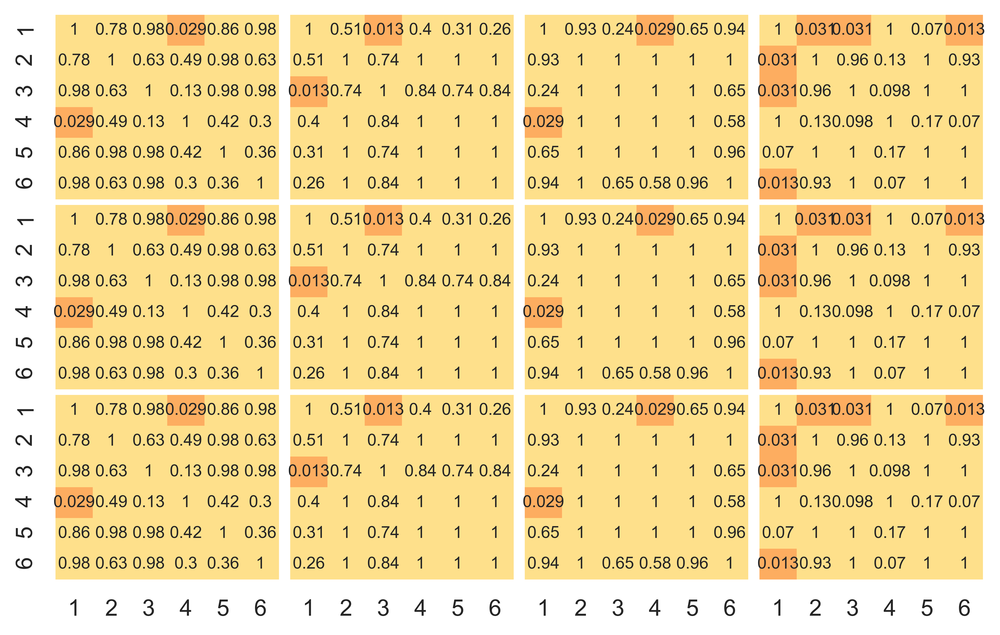

1


/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:194: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:199: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


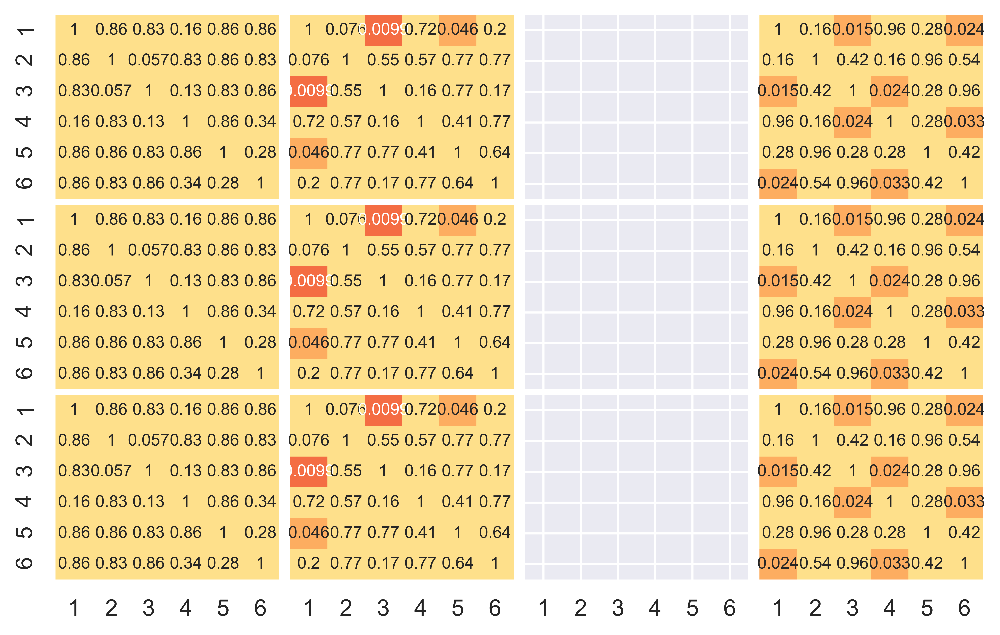

2


/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.l

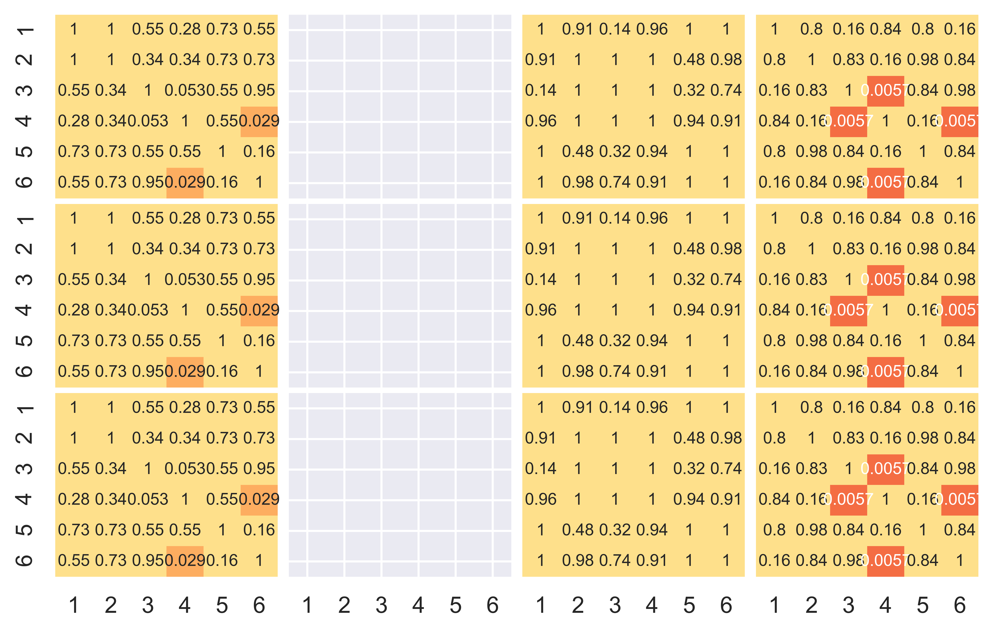

3


/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:194: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:199: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


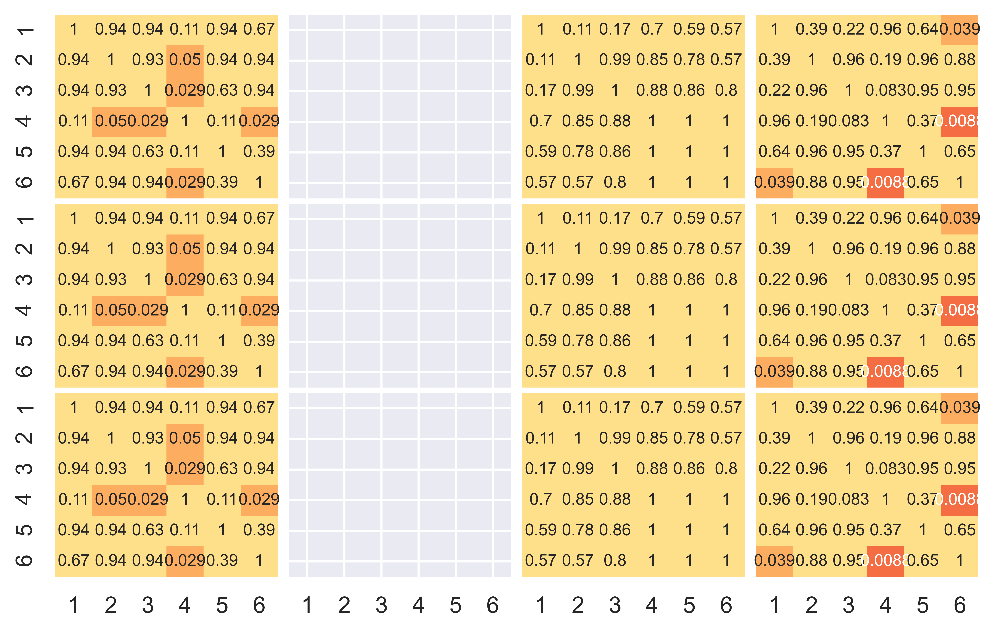

4


/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.l

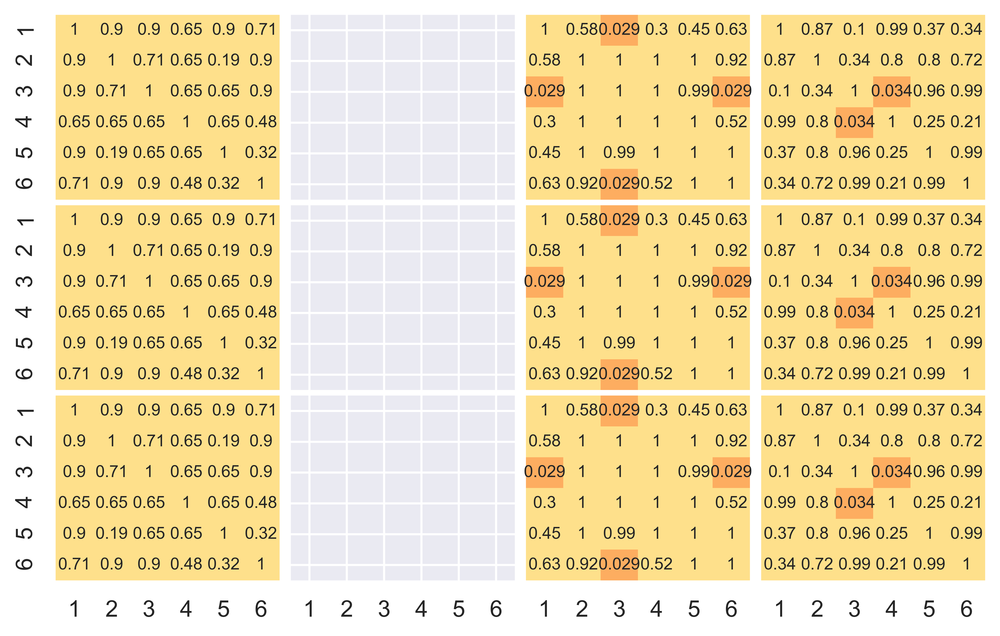

5


/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.l

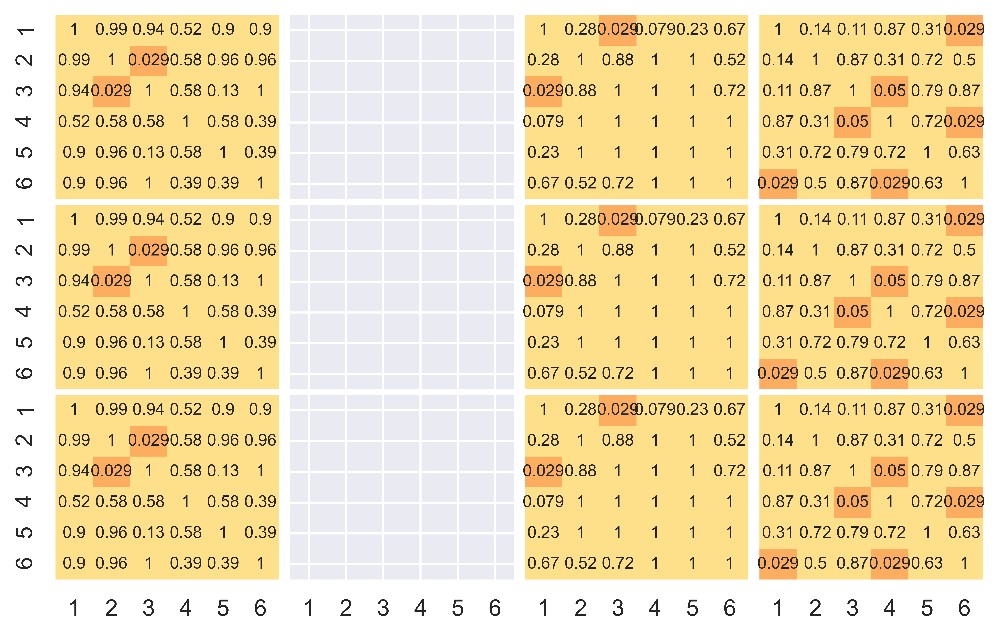

6


/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.log1p(-pvals))
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/statsmodels/stats/multitest.py:177: RuntimeWarning: divide by zero encountered in log1p
  np.l

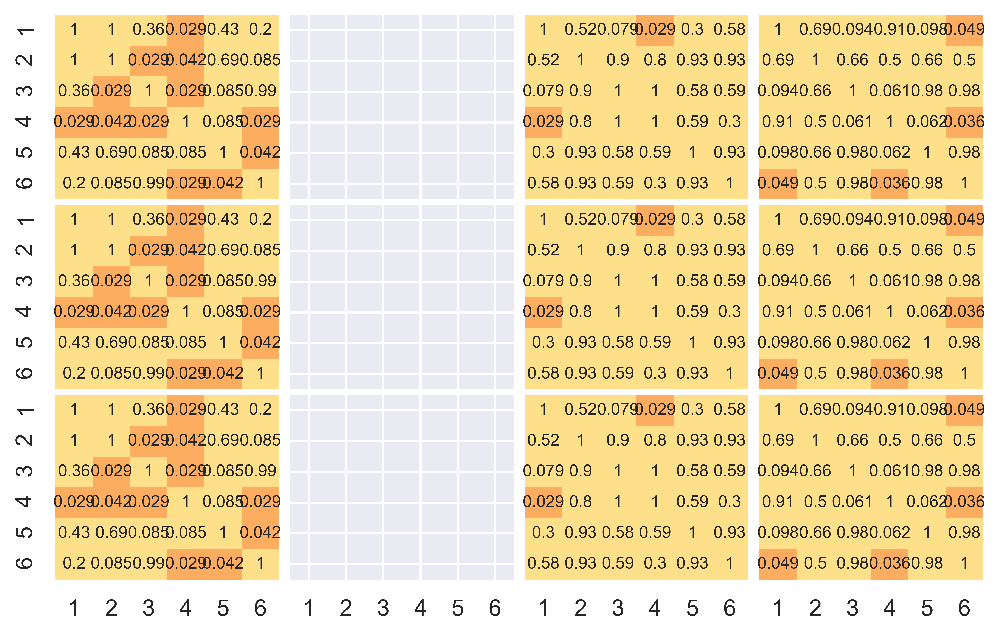

7


/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:194: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/Users/arielhannum/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:199: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


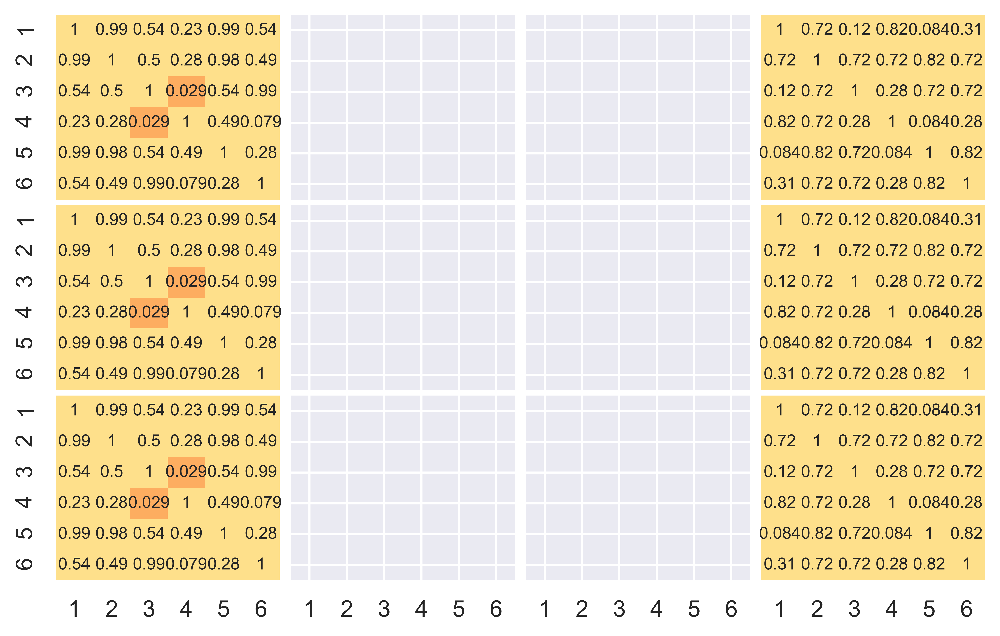

In [12]:
# Difference between slices for a give TD 
    
import scikit_posthocs as sp
from scipy import stats
for td in range(8):
    print(td)
    alpha= 0.05

    hypothesis = np.zeros((6,4,6,6))
    hypothesis[:] = np.nan

    slices = [2,1,0]
    for sl in range(6):
        for dd in range(4):
            group1 = std_all[0,dd,td,:,0]
            group2 = std_all[1,dd,td,:,1]
            group3 = std_all[2,dd,td,:,2]
            group4 = std_all[3,dd,td,:,0]
            group5 = std_all[4,dd,td,:,1]
            group6 = std_all[5,dd,td,:,2]

            normal = 0 if stats.shapiro(group1)[1] <alpha or stats.shapiro(group2)[1] <alpha or stats.shapiro(group1)[1] <alpha else 1

            if normal ==0:
                result = stats.friedmanchisquare(group1, group2, group3,group4, group5, group6)
                if result[1] < alpha:
                    test = sp.posthoc_wilcoxon([group1,group2,group3,group4, group5, group6],p_adjust = 'holm-sidak')
                    hypothesis[sl,dd,:,:] = test
                else:
                    hypothesis[sl,dd,:,:] = np.nan

            elif normal ==1:
                result = stats.f_oneway(group1, group2, group3,group4, group5, group6)
                if result[1] < alpha:
                    test = sp.posthoc_ttest([group1,group2,group3,group4, group5, group6],p_adjust = 'holm-sidak')
                    hypothesis[sl,dd,:,:] = test 
                else:
                    hypothesis[sl,dd,:,:] = np.nan



    from matplotlib.colors import BoundaryNorm, ListedColormap
    import seaborn as sns
    import numpy as np

    my_colors = [sns.color_palette("Spectral",9)[0], sns.color_palette("Spectral",9)[1], sns.color_palette("Spectral",9)[2], 
                sns.color_palette("Spectral",9)[3]]
    my_cmap = ListedColormap(my_colors)
    bounds = [0, 0.001, 0.01, 0.05,1]
    my_norm = BoundaryNorm(bounds, ncolors=len(my_colors))

    fig, axes = plt.subplots(3, 4, figsize=(8,5),sharex=True,sharey = True,dpi=1000)
    count = 2
    for sl in range(3):
        for dirs in range(4):
            ax=sns.heatmap(hypothesis[count,dirs,:,:],ax = axes[sl,dirs], annot = True, xticklabels=[1,2,3,4,5,6],
                        yticklabels=[1,2,3,4,5,6],norm=my_norm,cmap = my_cmap,cbar = False,annot_kws={"fontsize":8})
            #c_bar = ax.collections[0].colorbar
            #c_bar.set_ticks([(0 + 0.001)/2,(0.001+0.01)/2,(0.01+0.05)/2,(0.05+1)/2])
            #c_bar.set_ticklabels(['p<0.001','p<0.01','p<0.05','n.s.'])  
            #c_bar.set_ticklabels(['p<0.001','p<0.01','p<0.05','n.s.'])  


        count = count -1

    plt.subplots_adjust(wspace=0.05, hspace=0.03)
    plt.show()




In [13]:
3e7/

SyntaxError: invalid syntax (<ipython-input-13-48d6d786504d>, line 1)